# **Advanced Lane Finding** 
***
Beside I have met all rubric items, I would have liked to have improved more the code:
- building classes 
- improving the performance and robustness of the system

but I am running out of time.

I have tested all steps on all test images, that is the reason this doc is long but not dense since I don't describe every detail of the code.

This doc and aditional material can be accesed on the web in this link:

http://www.lite.etsii.urjc.es/asa/videos/CarND/CarND-P4/

# **Introduction** 
I import main libraries and show a test image

In [3]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
import glob
%matplotlib inline

This image is: <class 'numpy.ndarray'> with dimesions: (720, 1280, 3)


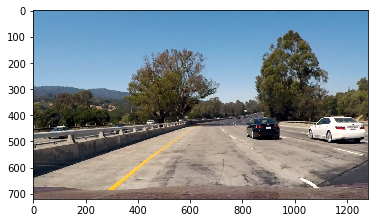

In [4]:
#reading in an image
image = mpimg.imread('test_images/test1.jpg')
#printing out some stats and plotting
print('This image is:', type(image), 'with dimesions:', image.shape)
plt.imshow(image)  #call as plt.imshow(gray, cmap='gray') to show a grayscaled image

# **Camera Calibration** 
# *Corner Detection* 
The next code detect corners and draw them on images

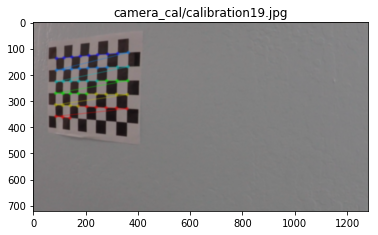

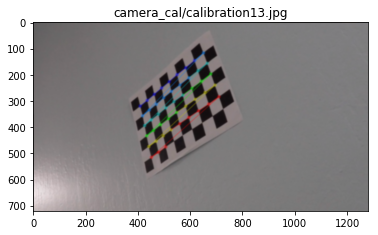

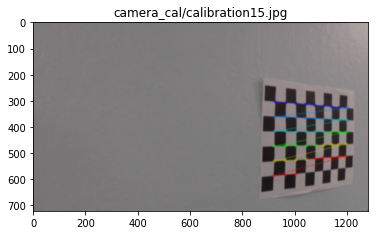

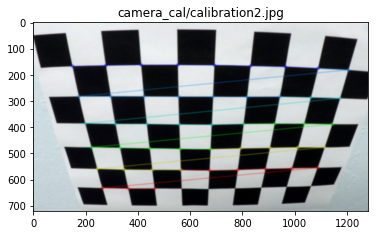

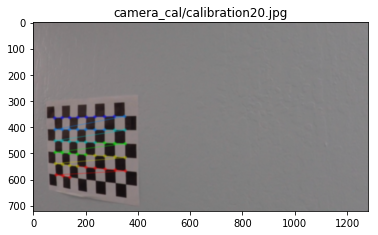

...

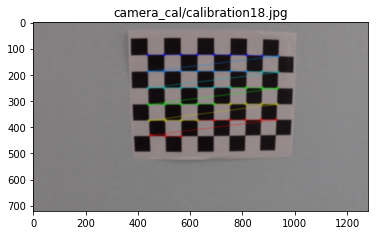

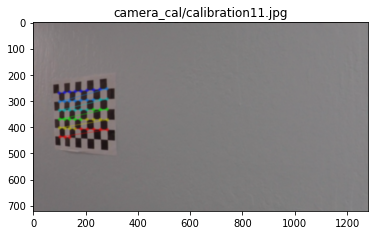

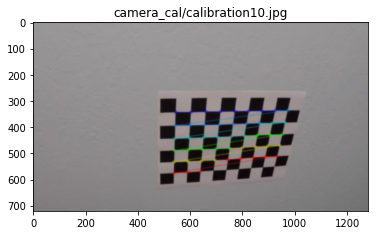

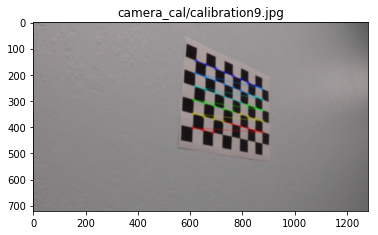

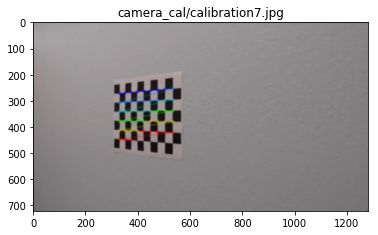

In [5]:

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
cornersRow=6
cornersCol=9
objp = np.zeros((cornersRow*cornersCol,3), np.float32)
#We are thinking of a 0.03m x 0.03m squares in the chessboard
objp[:,:2] = np.mgrid[0:cornersCol, 0:cornersRow].T.reshape(-1,2)*0.03


# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (cornersCol,cornersRow), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, (8,6), corners, ret)
        #write_name = 'corners_found'+str(idx)+'.jpg'
        #cv2.imwrite(write_name, img)
        plt.figure()
        plt.title(fname)
        plt.imshow(img, cmap = 'gray', interpolation = 'bicubic')
        plt.show()



# **Calibration process** 
The next code take the object points and image points and do calibrate the camera.

In order to se that it work fine undistort a image and save to output_images directory.

Save in a pickle file the intrinsic matrix and distortion matrix values

len(objpoints)= 17
len(imgpoints)= 17
mtx= [[  1.15777818e+03   0.00000000e+00   6.67113986e+02]
 [  0.00000000e+00   1.15282212e+03   3.86124636e+02]
 [  0.00000000e+00   0.00000000e+00   1.00000000e+00]]
dist= [[-0.24688444 -0.02373395 -0.00109833  0.00035111 -0.00259556]]


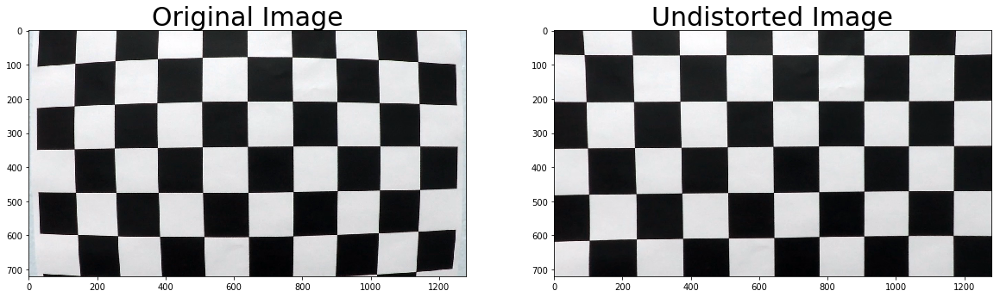

In [6]:
import pickle
%matplotlib inline

# Test undistortion on an image
img = cv2.imread('camera_cal/calibration1.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

print("len(objpoints)=",len(objpoints))
print("len(imgpoints)=",len(imgpoints))
print("mtx=",mtx)
print("dist=",dist)
dst = cv2.undistort(img, mtx, dist, None, mtx)
cv2.imwrite('./output_images/calibration7_undist.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "camera_cal/wide_dist_pickle.p", "wb" ) )
#dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
# Visualize undistortion
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=30)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=30)

# **Util math functions**
Some util functions from P1

In [7]:
import math

def undistor(img):
    """Applies undistortion transform with implicit matrix mtx global
    and distortio coeficients dist global too"""
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    return dst
def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def draw_lines(img, lines, color=[255, 0, 0], thickness=2):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape, 3), dtype=np.uint8)
    draw_lines(line_img, lines)
    return line_img

# Python 3 has support for cool math symbols.

def weighted_img(img, initial_img, α=0.8, β=1., λ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + λ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, λ)

## P1 pipeline 
I use pipeline of P1 in order to evaluate and try the perspective transform.


In [8]:
import os
os.listdir("test_images/")

['straight_lines1.jpg',
 'test2.jpg',
 'test5.jpg',
 'test3.jpg',
 'straight_lines2.jpg',
 'test6.jpg',
 'test1.jpg',
 'test4.jpg']

In [9]:
def cannyPipe(image):
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 5
    blur_gray = cv2.GaussianBlur(gray,(kernel_size, kernel_size),0)
    # Define our parameters for Canny and apply
    low_threshold = 50
    high_threshold = 150
    edges = cv2.Canny(blur_gray, low_threshold, high_threshold)
    return edges
def pipeline(image):
    # grayscale the image
    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 5
    blur_gray = cv2.GaussianBlur(gray,(kernel_size, kernel_size),0)
    # Define our parameters for Canny and apply
    low_threshold = 50
    high_threshold = 150
    edges = cv2.Canny(blur_gray, low_threshold, high_threshold)
    
    # Next we'll create a masked edges image using cv2.fillPoly()
    mask = np.zeros_like(edges)   
    ignore_mask_color = 255   
    # This time we are defining a four sided polygon to mask
    imshape = image.shape
    vertices = np.array([[(              0, imshape[0]),
                          (imshape[1]*4.5/10, imshape[0]*6/10),
                          (imshape[1]*5.5/10, imshape[0]*6/10 ),
                          (imshape[1]     , imshape[0])]], dtype=np.int32)
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    masked_edges = cv2.bitwise_and(edges, mask)
    # Define the Hough transform parameters
    # Make a blank the same size as our image to draw on
    rho = 1 # distance resolution in pixels of the Hough grid
    theta = np.pi/180 # angular resolution in radians of the Hough grid
    threshold = 10     # minimum number of votes (intersections in Hough grid cell)
    min_line_length = 10 #minimum number of pixels making up a line
    max_line_gap = 20    # maximum gap in pixels between connectable line segments
    line_image = np.copy(image)*0 # creating a blank to draw lines on
    # Run Hough on edge detected image
    # Output "lines" is an array containing endpoints of detected line segments
    lines = cv2.HoughLinesP(masked_edges, rho, theta, threshold, np.array([]),
                            min_line_length, max_line_gap)
    #k-mean like line clustering
    l_slope_mean=-0.72
    r_slope_mean= 0.56
    goodRLines=[]
    goodLLines=[]
    discardedLines=[]
    for line in lines:
        for x1,y1,x2,y2 in line:
            length=math.sqrt((x2-x1)**2+(y2-y1)**2)            
            if length>40:                
                slope=(y2-y1)/(x2-x1)
                if math.fabs(slope-l_slope_mean)<0.2:
                    goodLLines.append((x1,y1,x2,y2));
                    l_slope_mean=0.75*l_slope_mean+0.25*slope #new mean
                elif math.fabs(slope-r_slope_mean)<0.2:
                    goodRLines.append((x1,y1,x2,y2));
                    r_slope_mean=0.75*r_slope_mean+0.25*slope #new mean
                else:
                    discardedLines.append((x1,y1,x2,y2))
            else:
                discardedLines.append((x1,y1,x2,y2))
    # Iterate over the output "lines" and draw lines on a blank image
    #bound coordinates
    x1rm=image.shape[1]; y1rm=image.shape[0]; x2rm=y2rm=0
    for  x1,y1,x2,y2 in goodRLines:
        x1rm=min(x1rm,x1); y1rm=min(y1rm,y1); x2rm=max(x2rm,x2); y2rm=max(y2rm,y2)
    r_intercep=y1rm-r_slope_mean*x1rm
    #strech line to button
    yrmax=float(image.shape[0])
    xrmax=(yrmax-r_intercep)/r_slope_mean
    #print(xrmax,yrmax)
    cv2.line(line_image,(int(x1rm),int(y1rm)),(int(xrmax),int(yrmax)),(255,0,0),10)
    #bound coordinates
    x1lm=0; y1lm=image.shape[0]; x2lm=0; y2lm=image.shape[0]
    for  x1,y1,x2,y2 in goodLLines:
        x1lm=max(x1lm,x1); y1lm=min(y1lm,y1); x2lm=max(x2lm,x2); y2lm=min(y2lm,y2)
    l_intercep=y1lm-l_slope_mean*x1lm
    #strech line to button
    ylmax=float(image.shape[0])
    xlmax=(ylmax-l_intercep)/l_slope_mean
    #print(xlmax,ylmax)
    cv2.line(line_image,(int(xlmax),int(ylmax)),(int(x2lm),int(y2lm)),(255,0,0),10)

    # Create a "color" binary image to combine with line image
    color_edges = np.dstack((masked_edges, masked_edges, masked_edges)) 
    # Draw the lines on the edge image
    lines_edges = cv2.addWeighted( line_image, 0.8, image, 1, 0) 
    return lines_edges


This image is: straight_lines1.jpg with dimesions: (720, 1280, 3)
This image is: test2.jpg with dimesions: (720, 1280, 3)
This image is: test5.jpg with dimesions: (720, 1280, 3)
This image is: test3.jpg with dimesions: (720, 1280, 3)
This image is: straight_lines2.jpg with dimesions: (720, 1280, 3)
This image is: test6.jpg with dimesions: (720, 1280, 3)
This image is: test1.jpg with dimesions: (720, 1280, 3)
This image is: test4.jpg with dimesions: (720, 1280, 3)


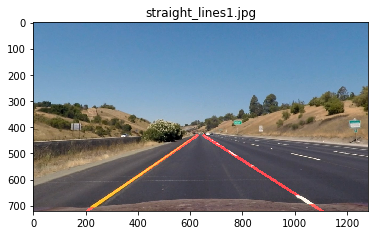

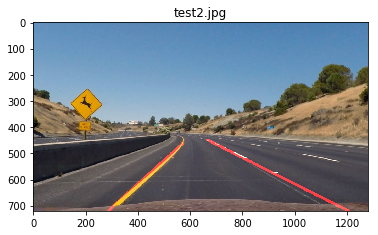

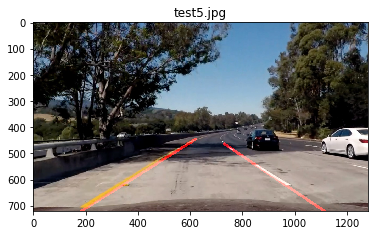

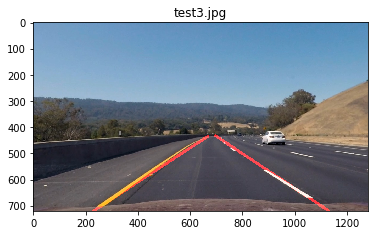

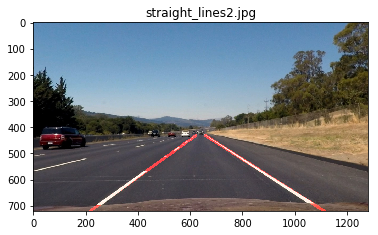

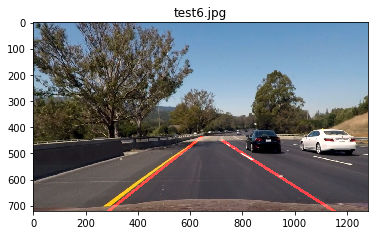

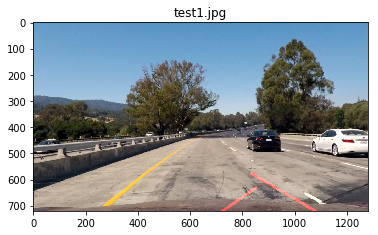

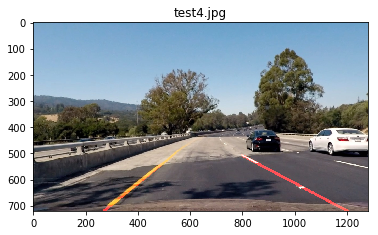

In [10]:
for fName in os.listdir("test_images/"):
    #imgs=os.listdir("test_images/")
    #fName=imgs[0]
    #reading in an image
    image = mpimg.imread("test_images/"+fName)
    #printing out some stats and plotting
    print('This image is:', fName, 'with dimesions:', image.shape)
    plt.figure()
    plt.title(fName)
    plt.imshow(pipeline(undistor(image)))  #call as plt.imshow(gray, cmap='gray') to show a grayscaled image
    

# **Perspective transform** 
Using images above I undistort images.

This point as been very dificult since you give wrong images, with wrong size.

I was strogling in order to get the right trapezoid to calculate prespective transform.

After some weeks I saw you changes images in github and put the right ones.

This image is: straight_lines1.jpg with dimesions: (720, 1280, 3)
This image is: test2.jpg with dimesions: (720, 1280, 3)
This image is: test5.jpg with dimesions: (720, 1280, 3)
This image is: test3.jpg with dimesions: (720, 1280, 3)
This image is: straight_lines2.jpg with dimesions: (720, 1280, 3)
This image is: test6.jpg with dimesions: (720, 1280, 3)
This image is: test1.jpg with dimesions: (720, 1280, 3)
This image is: test4.jpg with dimesions: (720, 1280, 3)


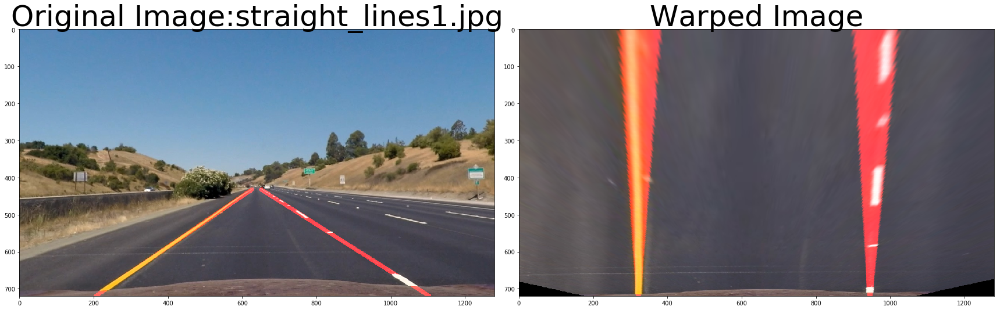

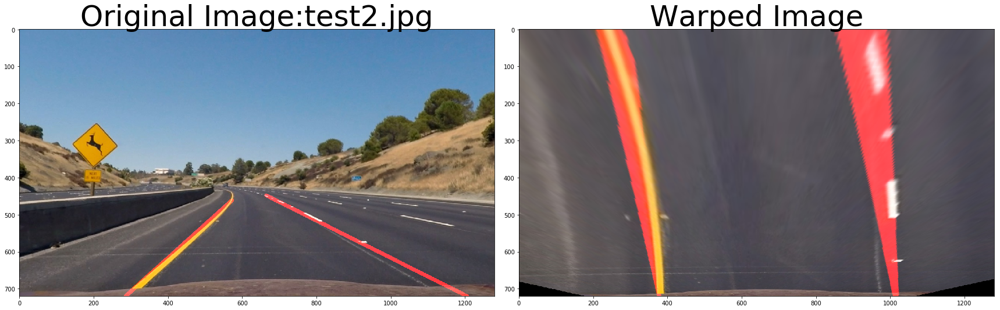

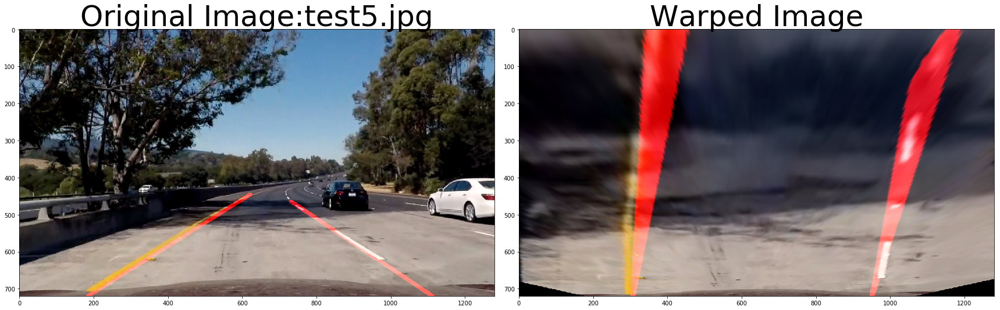

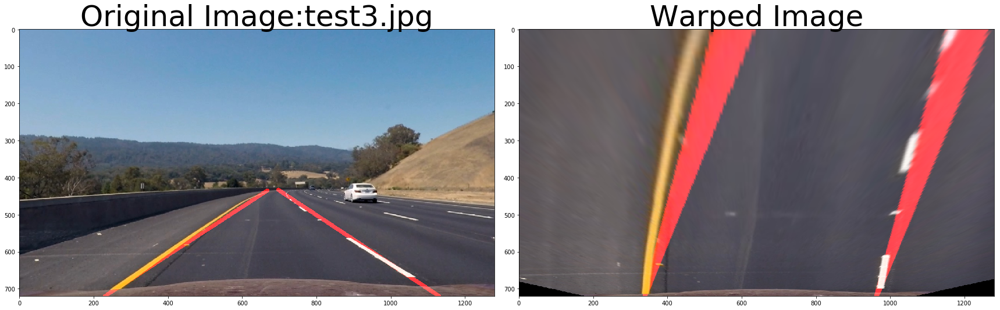

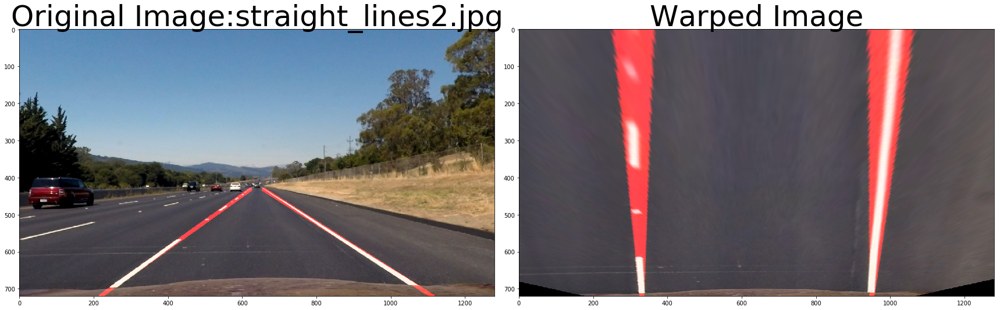

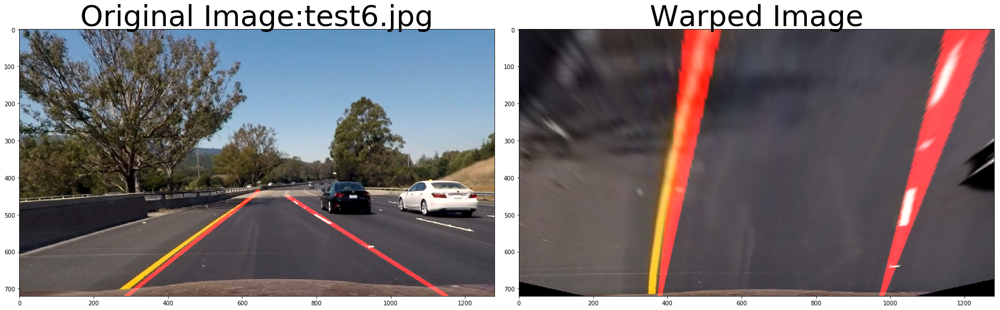

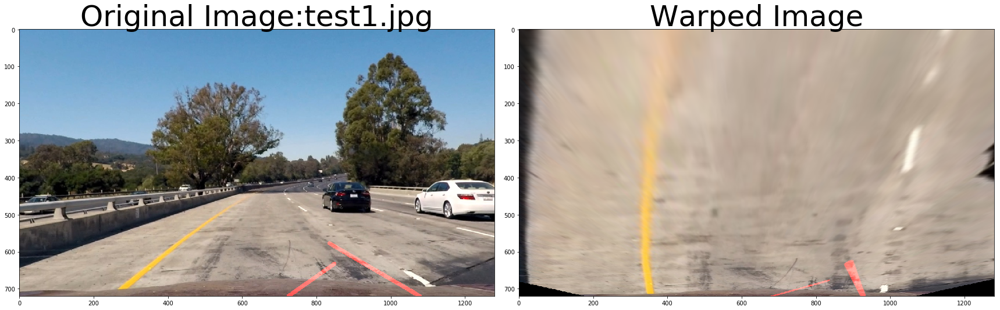

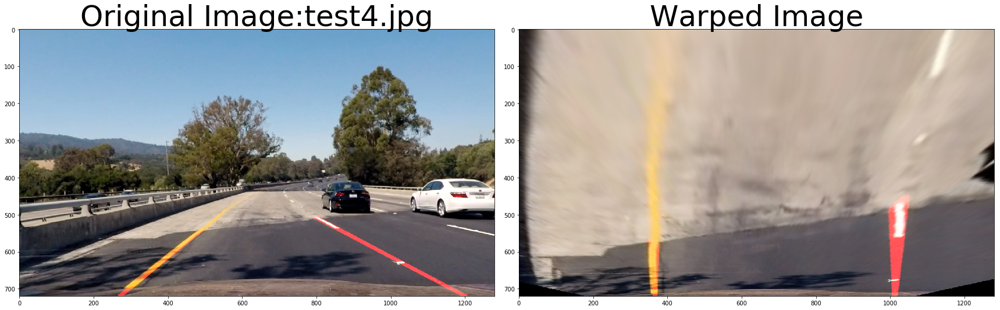

In [11]:
M=np.zeros((0,0))
Minv=np.zeros((0,0))
def warp(img):
    global Minv
    img_size=(img.shape[1],img.shape[0])
    w=img_size[0]
    h=img_size[1]
    src=np.float32([[585,460],[203,720],[ 1127,720],[695,460]])
    dst=np.float32([[320,0],[320,720],[960,720],[960,0]])
    M=cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped
for fName in os.listdir("test_images/"):
    #imgs=os.listdir("test_images/")
    #fName=imgs[0]
    #reading in an image
    image = mpimg.imread("test_images/"+fName)
    #printing out some stats and plotting
    print('This image is:', fName, 'with dimesions:', image.shape)
    p1img=pipeline(undistor(image))
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(p1img)
    ax1.set_title('Original Image:'+fName, fontsize=50)
    ax2.imshow(warp(p1img))
    ax2.set_title('Warped Image', fontsize=50)


# **Color, sobel gradient orientations and magnitude** 
This three functions work with sobel gradients
- abs_sobel_thresh
- mag_thresh
- dir_threshold

Images show orientatio and magnitude gradient combined

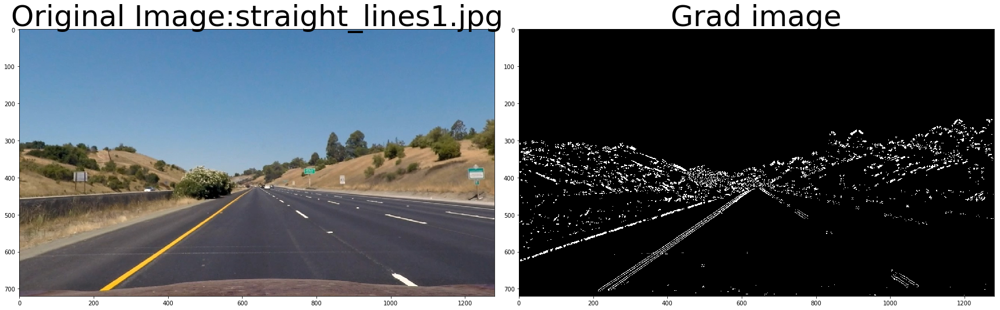

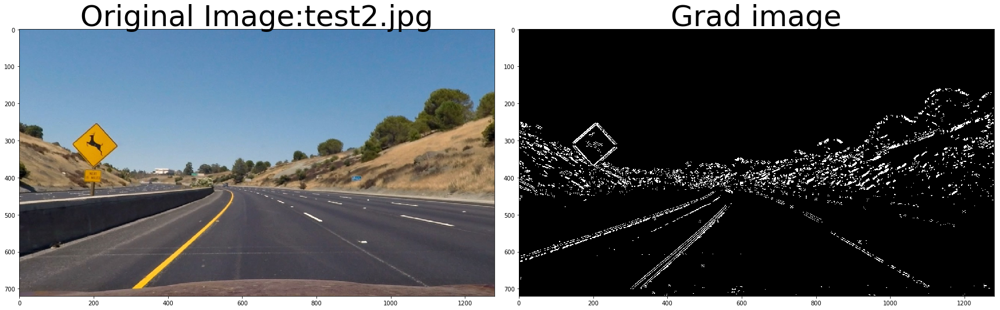

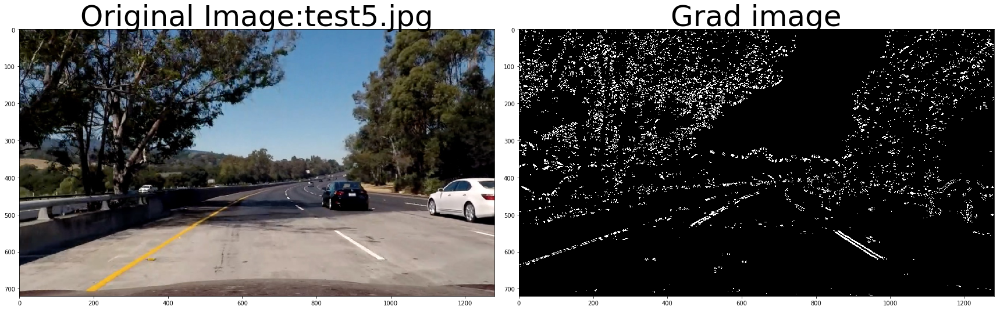

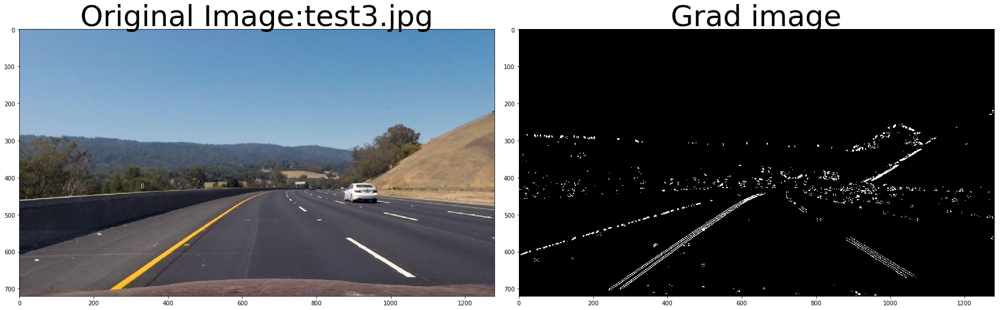

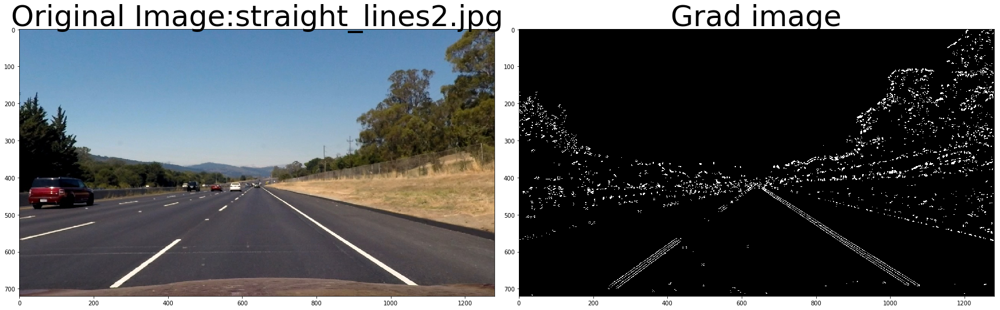

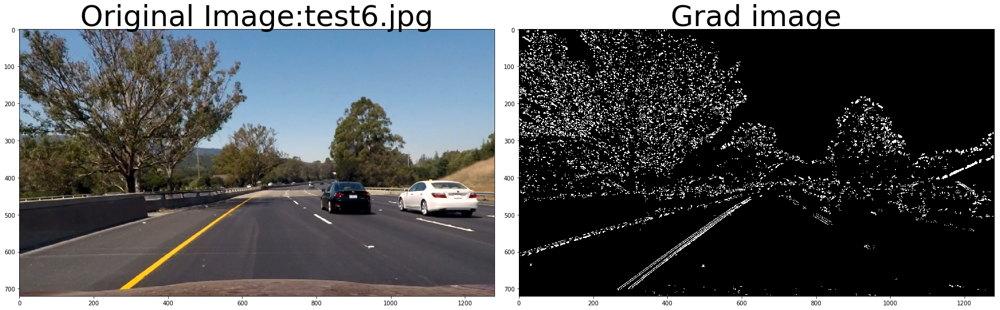

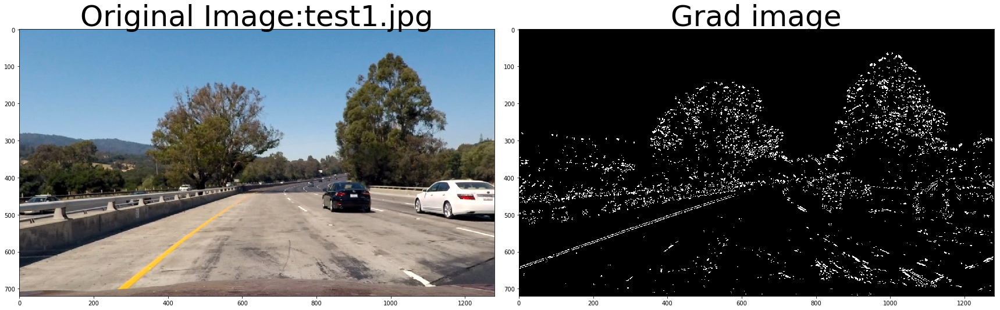

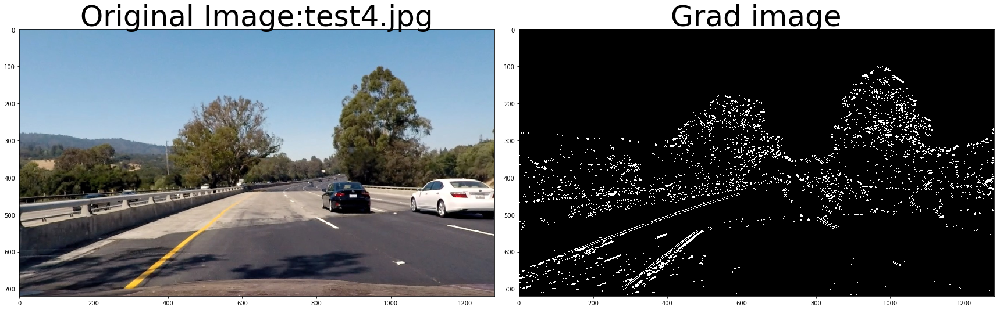

In [12]:
def abs_sobel_thresh(img, orient='x', thresh_min=0, thresh_max=255):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 5
    #gray = cv2.GaussianBlur(gray,(kernel_size, kernel_size),0)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    if orient=='x':
        sobel=sobelx
    else:
        sobel=sobely
    # 3) Take the absolute value of the derivative or gradient
    abs_sobel = np.absolute(sobel)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    # 6) Return this mask as your binary_output image
    binary_output = np.copy(sxbinary) # Remove this line
    return binary_output
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 5
    #gray = cv2.GaussianBlur(gray,(kernel_size, kernel_size),0)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    sobelx2=sobelx*sobelx
    sobely2=sobely*sobely
    sobelMag=np.sqrt(sobelx2+sobely2)
    # 5) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = np.uint8(255*sobelMag/np.max(sobelMag))
    # 6) Create a binary mask where mag thresholds are met
    thresh_min=mag_thresh[0]
    thresh_max=mag_thresh[1]
    sbinary = np.zeros_like(scaled_sobel)
    sbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    # 7) Return this mask as your binary_output image
    binary_output = np.copy(sbinary) # Remove this line
    return binary_output
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 5
    #gray = cv2.GaussianBlur(gray,(kernel_size, kernel_size),0)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient
    sobelDir=np.arctan2(abs_sobely,abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    thresh_min=thresh[0]
    thresh_max=thresh[1]
    sbinary = np.zeros_like(sobelDir)
    sbinary[(sobelDir >= thresh_min) & (sobelDir <= thresh_max)] = 1
    # 6) Return this mask as your binary_output image
    binary_output = np.copy(sbinary) # Remove this line
    return binary_output
for fName in os.listdir("test_images/"):
    #imgs=os.listdir("test_images/")
    #fName=imgs[0]
    #reading in an image
    image = undistor(mpimg.imread("test_images/"+fName))
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
    mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(30, 100))
    combined = np.zeros_like(dir_binary)
    combined[((mag_binary == 1) & (dir_binary == 1))] = 1
    #printing out some stats and plotting
    #print('This image is:', fName, 'with dimesions:', image.shape)
    p1img=pipeline(image)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image:'+fName, fontsize=50)
    ax2.imshow(combined, cmap='gray')
    ax2.set_title('Grad image', fontsize=50)


## ** Color threshold **
The function hls_select return a binary image from HLS threshold.
The function pipeline_thresh, is a first try to do combinned threshold.
Eventually the function my_pipeline_thresh define my own pipeline, after evaluating some parameters.


This image is: straight_lines1.jpg with dimesions: (720, 1280, 3)
This image is: test2.jpg with dimesions: (720, 1280, 3)
This image is: test5.jpg with dimesions: (720, 1280, 3)
This image is: test3.jpg with dimesions: (720, 1280, 3)
This image is: straight_lines2.jpg with dimesions: (720, 1280, 3)
This image is: test6.jpg with dimesions: (720, 1280, 3)
This image is: test1.jpg with dimesions: (720, 1280, 3)
This image is: test4.jpg with dimesions: (720, 1280, 3)


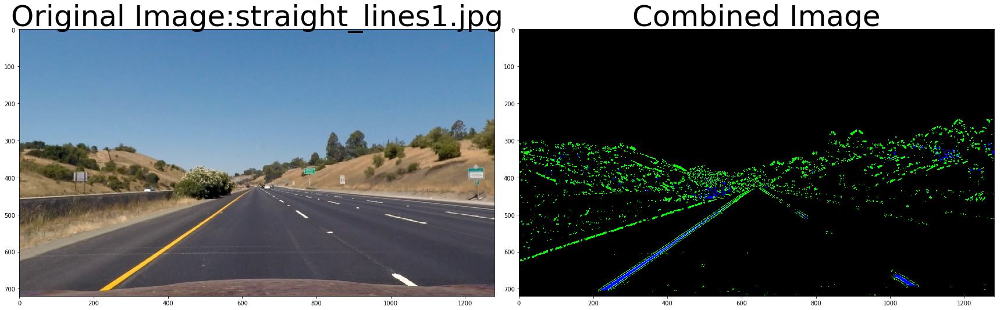

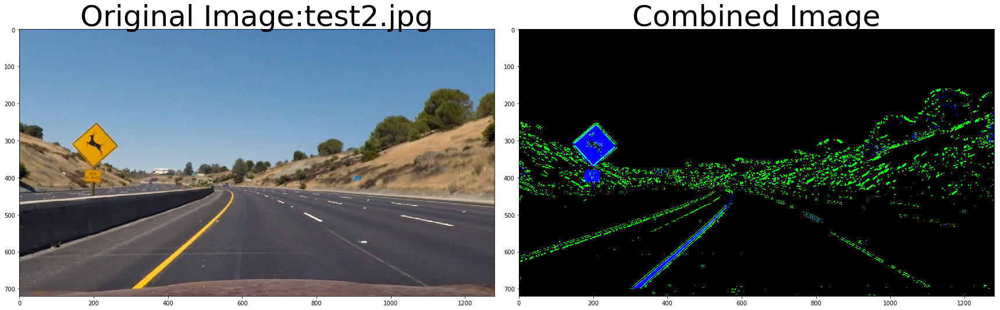

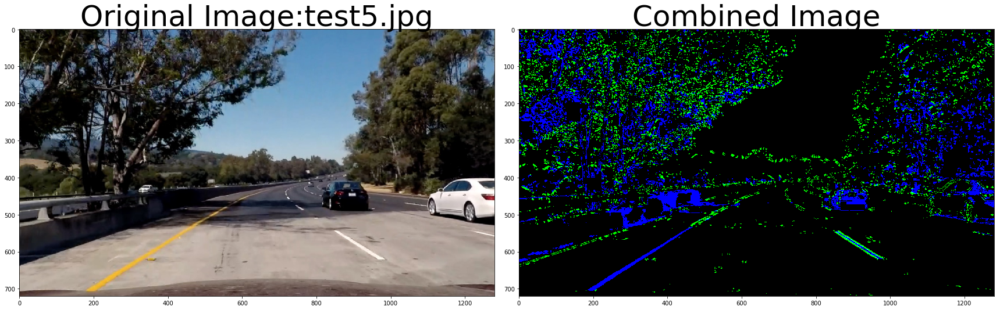

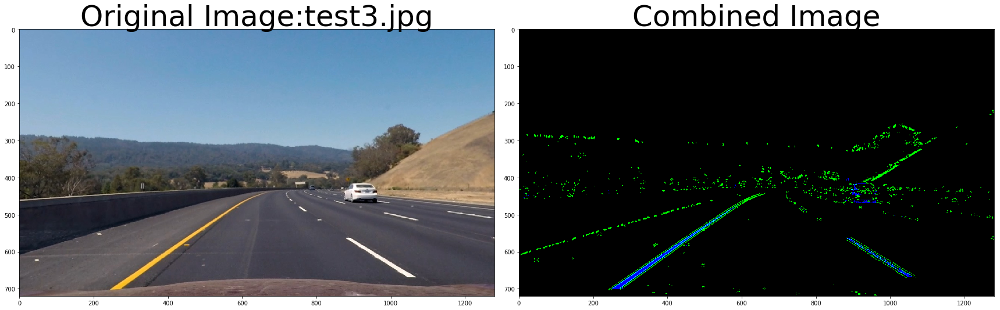

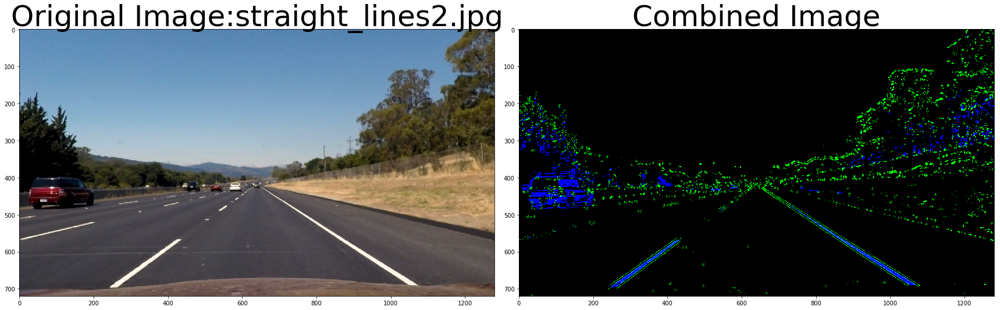

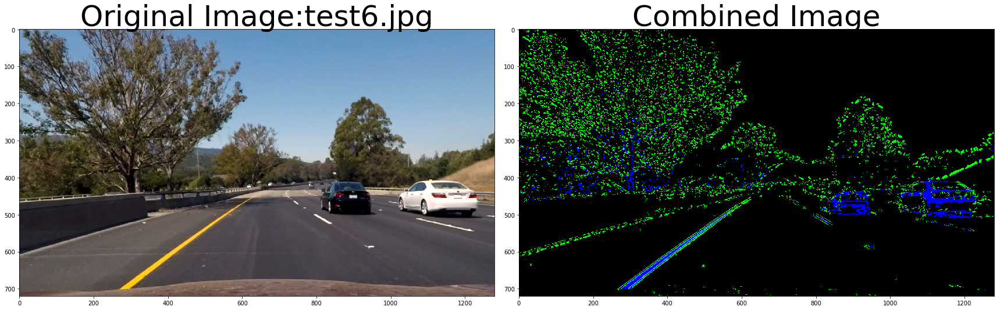

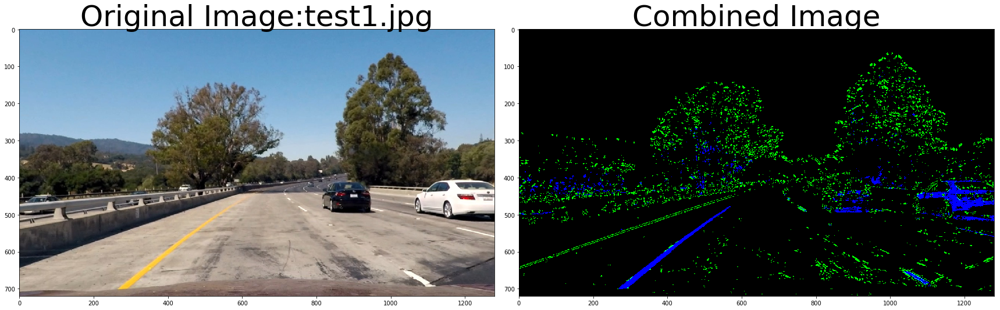

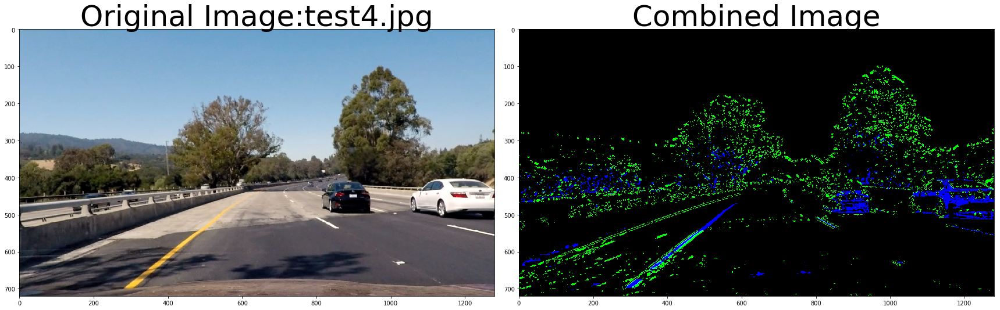

In [13]:
def hls_select(img, thresh=(0, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    # 2) Apply a threshold to the S channel
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    binary_output = np.copy(binary) # placeholder line
    return binary_output
def pipeline_thresh(img):
    img = np.copy(img)
    # Define a kernel size and apply Gaussian smoothing
    kernel_size = 5
    #img = cv2.GaussianBlur(img,(kernel_size, kernel_size),0)
    # Convert to HLS color space and separate the S channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s = hls[:,:,2]

    # Grayscale image
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abssx = np.absolute(sobelx) # Absolute x derivative to accentuate strong verticalish lines
    scale_factor = np.max(abssx)/255 # Will use this to scale back to 8-bit scale
    abssx = (abssx/scale_factor).astype(np.uint8) #rescaling to 8-bit 

    # Threshold x gradient
    retval, sxbinary = cv2.threshold(abssx, 15, 150, cv2.THRESH_BINARY)
    # Threshold color channel
    retval, s_binary = cv2.threshold(s.astype('uint8'), 175, 255, cv2.THRESH_BINARY)

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    return color_binary
def my_pipeline_thresh(image):
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
    mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(30, 100))
    combined = np.zeros_like(dir_binary)
    combined[((mag_binary == 1) & (dir_binary == 1))] = 1


    # Threshold mag and dir gradient
    sxbinary = combined
    # Threshold color channel
    s_binary = hls_select(image,(175,255))

    # Stack each channel to view their individual contributions in green and blue respectively
    # This returns a stack of the two binary images, whose components you can see as different colors
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    return color_binary

for fName in os.listdir("test_images/"):
    #imgs=os.listdir("test_images/")
    #fName=imgs[0]
    #reading in an image
    image = undistor(mpimg.imread("test_images/"+fName))
    color_binary=my_pipeline_thresh(image)
    #printing out some stats and plotting
    print('This image is:', fName, 'with dimesions:', image.shape)
    p1img=pipeline(image)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image)
    ax1.set_title('Original Image:'+fName, fontsize=50)
    ax2.imshow(color_binary)
    ax2.set_title('Combined Image', fontsize=50)


## ** Color & grad, final Combined pipeline **
This function:
- my_pipeline_thresh_binary

is like the one above but return a pure binary image not a colored image.

I take this images and do a perspective transform getting warped images.

This image is: straight_lines1.jpg with dimesions: (720, 1280, 3)
This image is: test2.jpg with dimesions: (720, 1280, 3)
This image is: test5.jpg with dimesions: (720, 1280, 3)
This image is: test3.jpg with dimesions: (720, 1280, 3)
This image is: straight_lines2.jpg with dimesions: (720, 1280, 3)
This image is: test6.jpg with dimesions: (720, 1280, 3)
This image is: test1.jpg with dimesions: (720, 1280, 3)
This image is: test4.jpg with dimesions: (720, 1280, 3)


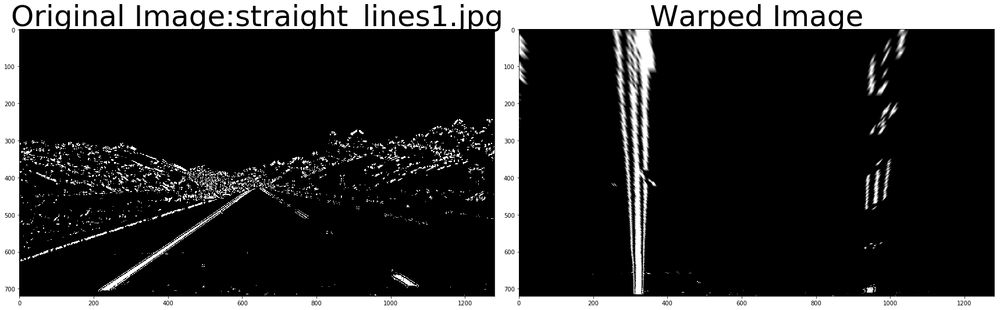

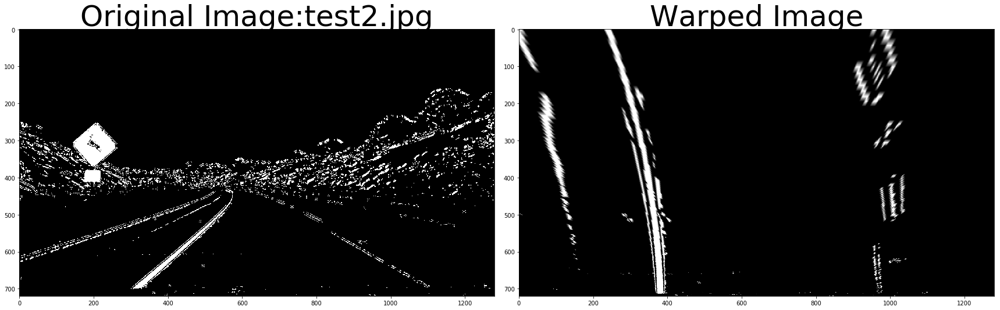

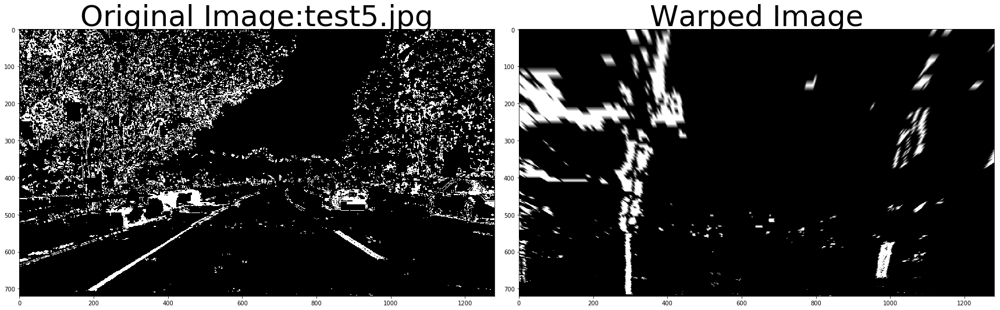

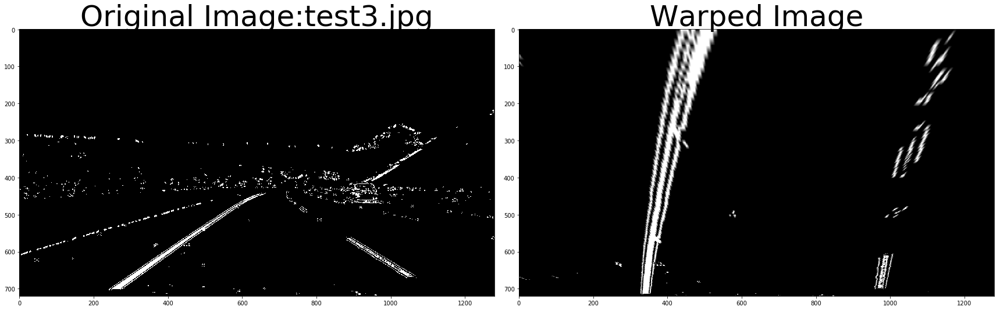

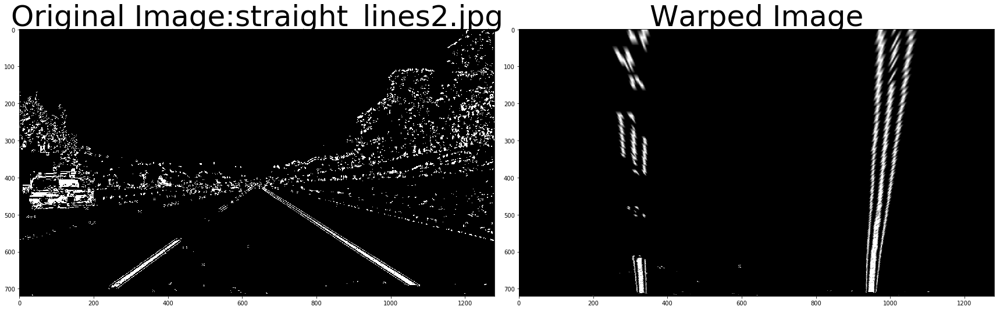

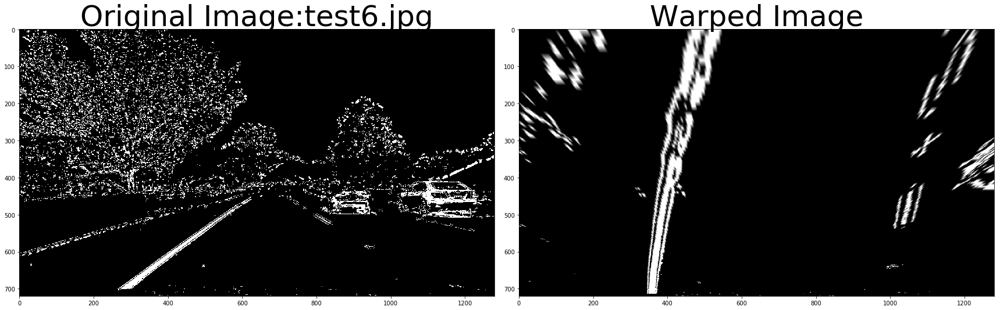

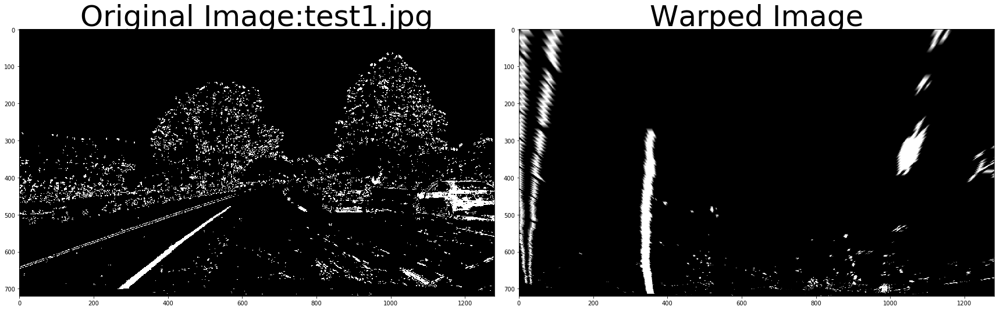

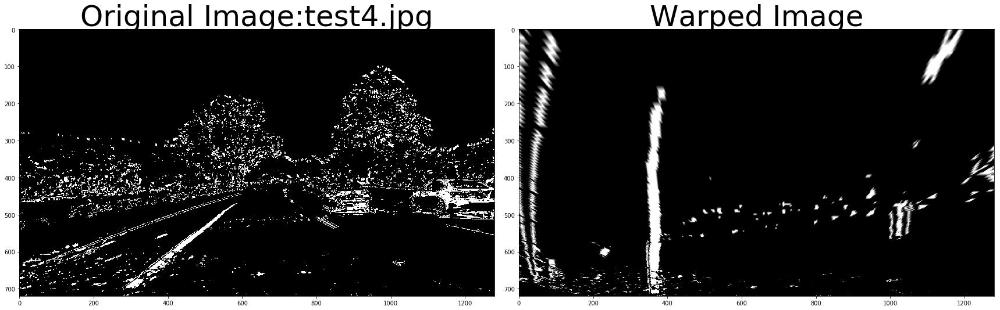

In [14]:
def my_pipeline_thresh_binary(image):
    dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
    mag_binary = mag_thresh(image, sobel_kernel=9, mag_thresh=(30, 100))
    hls_binary = hls_select(image,(175,255))
    combined = np.zeros_like(dir_binary)
    combined[((mag_binary == 1) & (dir_binary == 1) | (hls_binary==1))] = 1
    return combined
for fName in os.listdir("test_images/"):
    #imgs=os.listdir("test_images/")
    #fName=imgs[0]
    #reading in an image
    image = undistor(mpimg.imread("test_images/"+fName))
    color_binary=my_pipeline_thresh_binary(image)
    #printing out some stats and plotting
    print('This image is:', fName, 'with dimesions:', image.shape)
    p1img=pipeline(image)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(color_binary,cmap='gray')
    ax1.set_title('Original Image:'+fName, fontsize=50)
    ax2.imshow(warp(color_binary),cmap='gray')
    ax2.set_title('Warped Image', fontsize=50)


## ** Finding Peaks on histogram **
The next function find and return peaks on histogram for left and right lanes.

Images show the warped image and its histogram with values drawn near each peak.

This image is: straight_lines1.jpg with dimesions: (720, 1280)


/home/francisco/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel/__main__.py:4: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


xl= 317 355.037109375
xr= 938 80.67578125
xr-xl 621
This image is: test2.jpg with dimesions: (720, 1280)
xl= 374 261.864257812
xr= 1005 83.3330078125
xr-xl 631
This image is: test5.jpg with dimesions: (720, 1280)
xl= 289 281.65234375
xr= 986 87.328125
xr-xl 697
This image is: test3.jpg with dimesions: (720, 1280)
xl= 355 208.701171875
xr= 980 60.830078125
xr-xl 625
This image is: straight_lines2.jpg with dimesions: (720, 1280)
xl= 328 93.916015625
xr= 954 217.883789062
xr-xl 626
This image is: test6.jpg with dimesions: (720, 1280)
xl= 372 210.966796875
xr= 1049 50.9375
xr-xl 677
This image is: test1.jpg with dimesions: (720, 1280)
xl= 346 353.810546875
xr= 1026 45.6494140625
xr-xl 680
This image is: test4.jpg with dimesions: (720, 1280)
xl= 357 339.73828125
xr= 1026 91.892578125
xr-xl 669


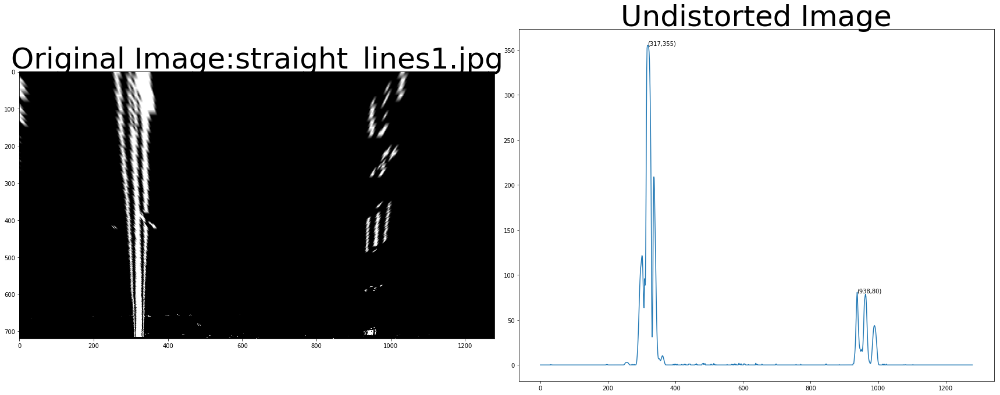

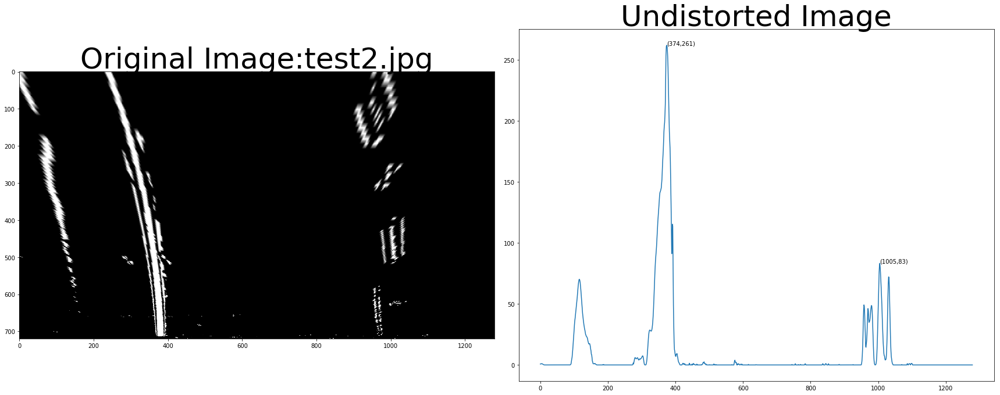

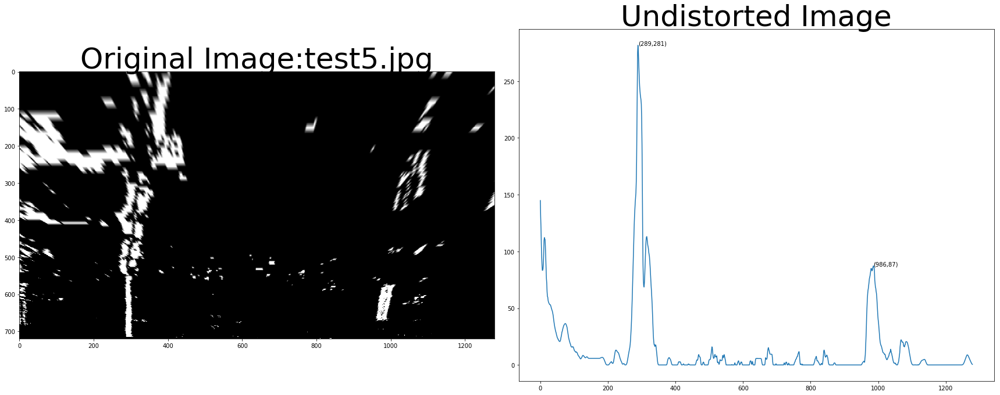

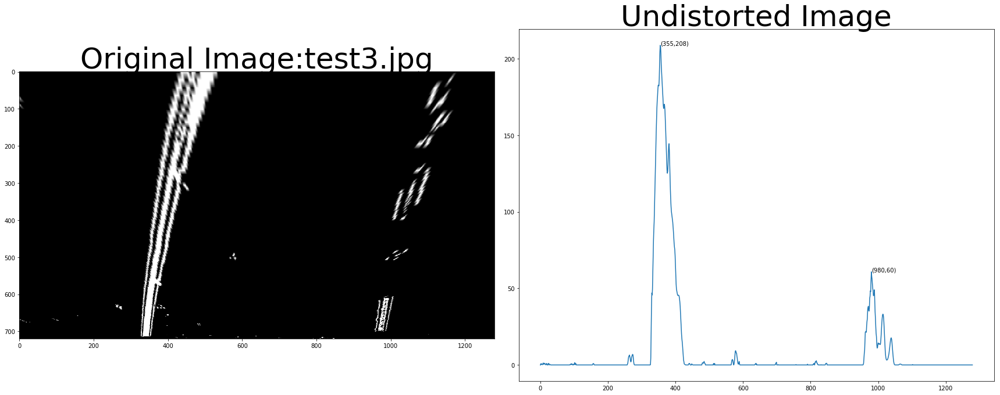

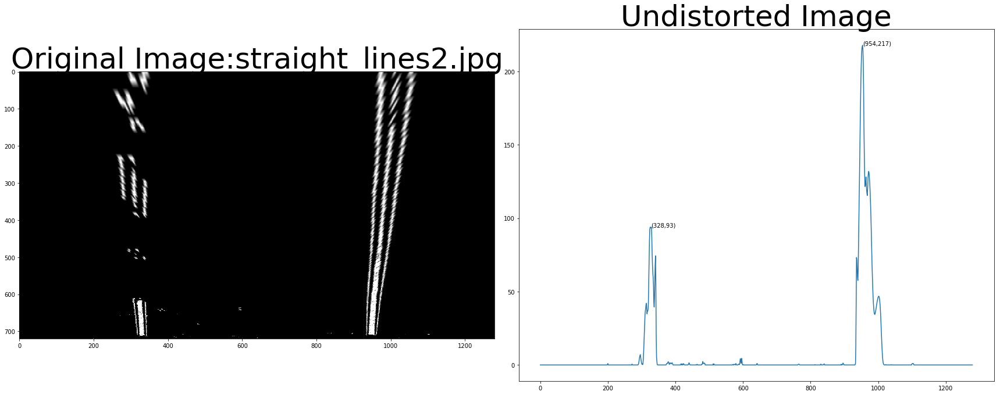

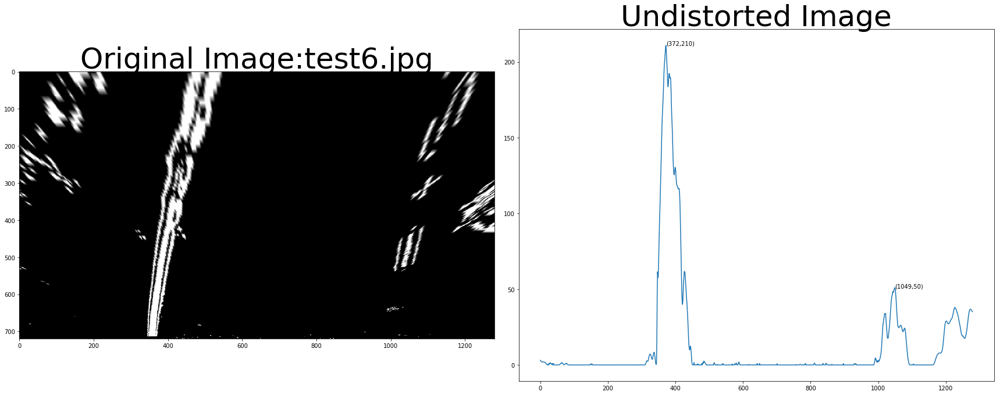

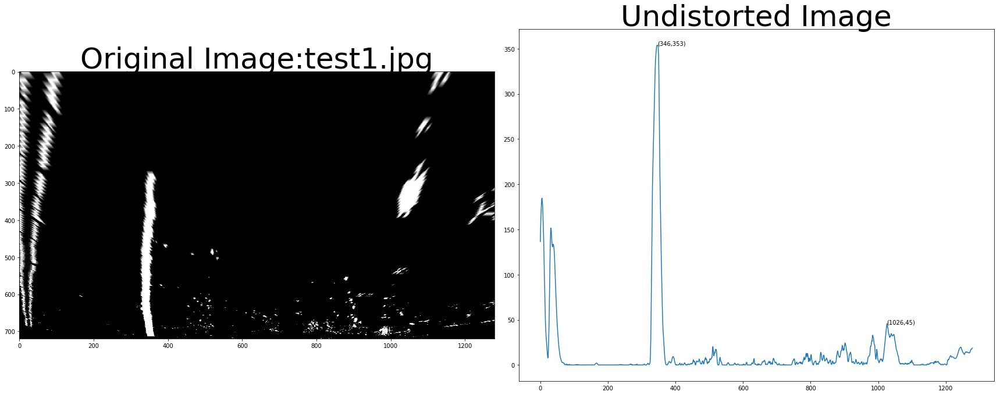

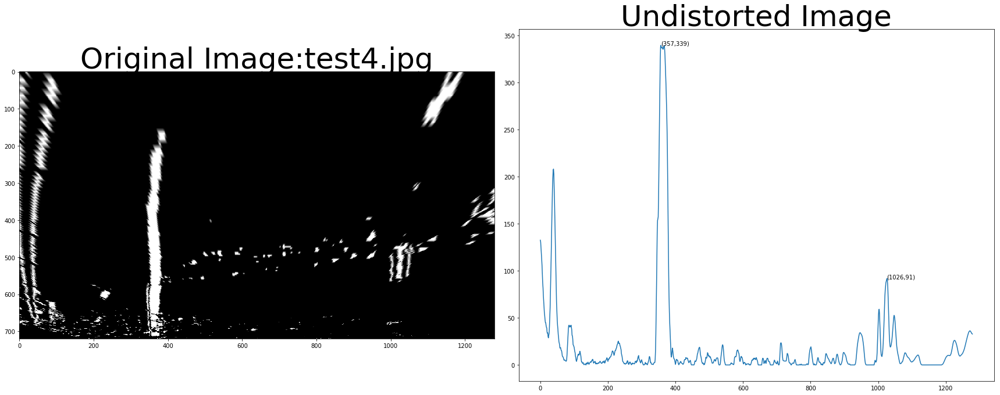

In [15]:
def getHistPeaks(img):
    """ This function find picks in a Histogran.
    """
    histogram = np.sum(img[img.shape[0]/2:,:], axis=0)
    xl=np.argmax(histogram[:600])
    yl=np.max(histogram[:600])
    xr=np.argmax(histogram[601:])+601
    yr=np.max(histogram[601:])
    pxRoadWidth=xr-xl
    return ((xl,yl),(xr,yr),pxRoadWidth,histogram)

    
for fName in os.listdir("test_images/"):
    #imgs=os.listdir("test_images/")
    #fName=imgs[0]
    #reading in an image
    image = undistor(mpimg.imread("test_images/"+fName))
    pipe_binary=my_pipeline_thresh_binary(image)
    warp_binary=warp(pipe_binary)
    #printing out some stats and plotting
    print('This image is:', fName, 'with dimesions:', warp_binary.shape)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(warp_binary,cmap='gray')
    ax1.set_title('Original Image:'+fName, fontsize=50)
    img=warp_binary
    (xl,yl),(xr,yr),pxRoadWidth,histogram=getHistPeaks(img)
    nl="(%i,%i)" % (xl,yl)
    ax2.annotate(nl,xy=(xl,yl))
    print("xl=",xl,yl)
    nr="(%i,%i)" % (xr,yr)    
    ax2.annotate(nr,xy=(xr,yr))
    print("xr=",xr,yr)
    print("xr-xl",pxRoadWidth)
    ax2.plot(histogram)
    ax2.set_title('Undistorted Image', fontsize=50)


## ** Main pipeline functions **
### ** Detection lanes **
The function:
- detectSlidingWindows

does the main work on lane detections as taught in the course.
The function:
- pipeWindow

does this sequence of step:
- Get binary trheshold image: pipe_binary=my_pipeline_thresh_binary(image)
- Warp image: warp_binary=warp(pipe_binary)
- Detect lanes:    color_warp,left_fit,right_fit,left_curverad,right_curverad,center_offset=detectSlidingWindows(warp_binary)
- Write information on image
- return image and parameter fitting

### ** Tracking lanes **
The function:
- trackSlidingWindows
does traking lanes from previous fitting parameters as taught in the course.
The function:
- trackPipeWindow
does this sequence of step:
- Get binary trheshold image: pipe_binary=my_pipeline_thresh_binary(image)
- Warp image: warp_binary=warp(pipe_binary)
- Track lanes, from previous parameters:    color_warp,left_fit,right_fit,left_curverad,right_curverad,center_offset=trackSlidingWindows(warp_binary,left_fit,right_fit)
- Write information on image
- return image and parameter fitting
### ** Curvature Radius and center offset **
This function:

- curveRadius

Works out curvature radius in metres as you teached on the course and calculate center offset as average from left_center_offset and right_center_offset given the image center in metres by xmCenter.


/home/francisco/anaconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel/__main__.py:36: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future


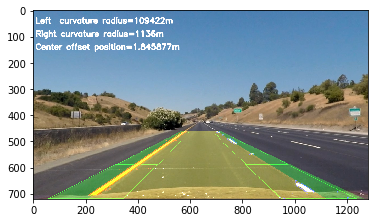

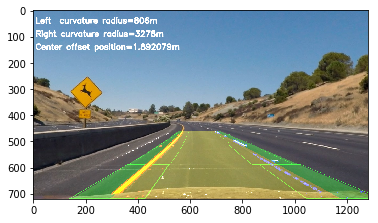

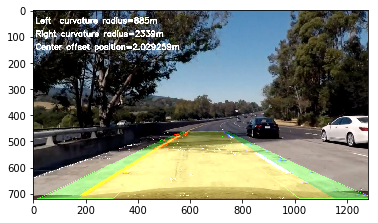

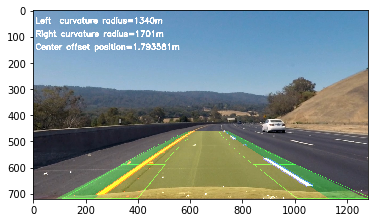

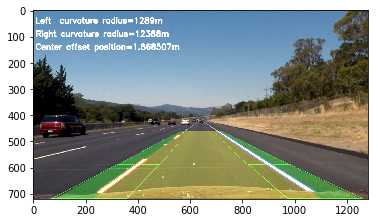

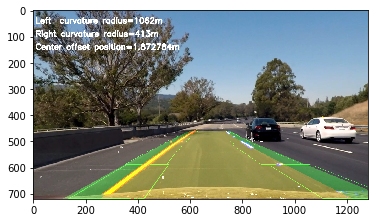

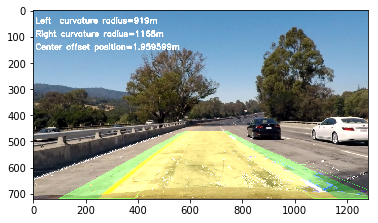

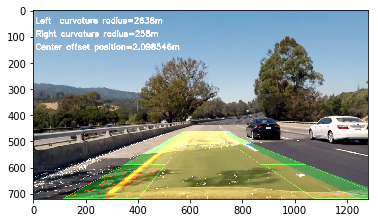

In [16]:
#Slice the image in n vertical locations of size height
def slicer(img,pos,height=72):
    return img[pos*height:pos*height+height,:]
#return a subimage of size w,h with corner cx,cy
def roiRec(img,cx,cy,w=72,h=72):
    xi=cx
    xe=cx+w
    yi=cy
    ye=cy+h
    print("roiRec=",xi,xe,yi,ye)
    return img[yi:ye,xi:xe]
def curveRadius(left_fitx,right_fitx,ploty):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    xmCenter=xm_per_pix*1280.0/2.0
    y_eval = np.max(ploty)
    # Fit new polynomials to x,y in world space
    left_fit_cr  = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Center offset
    left_center_offset=xmCenter-left_fit_cr[-1]
    right_center_offset=right_fit_cr[-1]-xmCenter
    center_offset=(left_center_offset+right_center_offset)/2
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters
    return left_curverad,right_curverad,center_offset

def detectSlidingWindows(bw):
    bw*=255.0
    binary_warped=bw.astype(np.uint8)
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    #y_eval = np.max(ploty)
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    window_img = np.zeros_like(out_img)
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([pts]), (255,255, 0))
    out_img = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    # Now our radius of curvature is in meters
    left_curverad,right_curverad,center_offset=curveRadius(left_fitx,right_fitx,ploty)
    
    #plt.figure()
    #plt.imshow(out_img)
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    #plt.xlim(0, 1280)
    #plt.ylim(720, 0)
    return out_img,left_fit,right_fit,left_curverad,right_curverad,center_offset
def pipeWindow(image):
    image = undistor(image)
    pipe_binary=my_pipeline_thresh_binary(image)
    warp_binary=warp(pipe_binary)
    color_warp,left_fit,right_fit,left_curverad,right_curverad,center_offset=detectSlidingWindows(warp_binary)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    result = cv2.addWeighted(image, 1, newwarp, 1, 0)
    font = cv2.FONT_HERSHEY_SIMPLEX
    sl='Left  curvature radius=%dm'% left_curverad
    cv2.putText(result,sl,(10,50), font, 1,(255,255,255),4,cv2.LINE_AA)
    sr='Right curvature radius=%dm'% right_curverad
    cv2.putText(result,sr,(10,100), font, 1,(255,255,255),4,cv2.LINE_AA)
    sr='Center offset position=%fm'% center_offset
    cv2.putText(result,sr,(10,150), font, 1,(255,255,255),4,cv2.LINE_AA)
    #plt.figure()
    return result,left_fit,right_fit
def trackSlidingWindows(bw,left_fit,right_fit):
    bw*=255.0
    binary_warped=bw.astype(np.uint8)
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 75
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Now our radius of curvature is in meters
    left_curverad,right_curverad,center_offset=curveRadius(left_fitx,right_fitx,ploty)

    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([pts]), (255,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    #plt.imshow(result)
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')
    #plt.xlim(0, 1280)
    #plt.ylim(720, 0)  
    return result,left_fit,right_fit,left_curverad,right_curverad,center_offset
def trackPipeWindow(image,left_fit,right_fit):
    image = undistor(image)
    pipe_binary=my_pipeline_thresh_binary(image)
    warp_binary=warp(pipe_binary)
    color_warp,left_fit,right_fit,left_curverad,right_curverad,center_offset=trackSlidingWindows(warp_binary,left_fit,right_fit)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 
    result = cv2.addWeighted(image, 1, newwarp, 1, 0)
    font = cv2.FONT_HERSHEY_SIMPLEX
    sl='Left  curvature radius=%dm'% left_curverad
    cv2.putText(result,sl,(10,50), font, 1,(255,255,255),4,cv2.LINE_AA)
    sr='Right curvature radius=%dm'% right_curverad
    cv2.putText(result,sr,(10,100), font, 1,(255,255,255),4,cv2.LINE_AA)
    sr='Center offset position=%fm'% center_offset
    cv2.putText(result,sr,(10,150), font, 1,(255,255,255),4,cv2.LINE_AA)
    #plt.figure()
    return result,left_fit,right_fit
    
lPtsROIs=[]
rPtsROIs=[]
fNames=["test3.jpg"]
for fName in os.listdir("test_images/"):
    image = mpimg.imread("test_images/"+fName)
    imgW=image.shape[1]
    imgH=image.shape[0]
    result,left_fit,right_fit=pipeWindow(image)
    plt.figure()
    plt.imshow(result)



## **Pipeline (video)**
In process_image apply pixel identification and polinomial fitting with first image, calling:

pipeWindow

and do traking with other images, calling:

trackPipeWindow

I do a smoothing of parameter fitting.

You can find the video in this link:

http://www.lite.etsii.urjc.es/asa/videos/CarND/CarND-P4/project_video_output.mp4


In [17]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [18]:
frameCount=0
left_fit=[0,0,0]
right_fit=[0,0,0]
def process_image(image):
    global frameCount,left_fit,right_fit
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image with lines are drawn on lanes)
    #gray=edgesPipe(image)
    #result=cv2.cvtColor(gray,cv2.COLOR_GRAY2RGB)
    if frameCount==0:
        result,left_fit,right_fit=pipeWindow(image)
    else:
        result,left_fitNew,right_fitNew=trackPipeWindow(image,left_fit,right_fit)
        left_fit=left_fit*0.99+left_fitNew*0.01
        right_fit=right_fit*0.99+right_fitNew*0.01
    frameCount+=1
    return result

Let's try the one with the solid white lane on the right first ...

In [19]:
white_output = 'project_video_output.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [09:06<00:00,  2.11it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 9min 29s, sys: 2.98 s, total: 9min 32s
Wall time: 9min 10s


Play the video inline, or if you prefer find the video in your filesystem (should be in the same directory) and play it in your video player of choice.

In [20]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

# Discussion
I thought on adding a kalman filter for each lane pos but I don't have time.

I would be convenient to alternate from detecting and traking from some precision evaluation on the tracking process.

Eventually if tracking and detections fails It would take the last robust parameters.

The code works fine with the project_video and in all test images.

## ** Tracking **
I have implemented trackPipeWindow for tracking once a lane has been detected.

##  ** Smoothing **
In process_image I do a smothing average of previous fitting parameters values with the new ones.
